In [ ]:
import numpy as np
import sklearn as sk
import pandas as pd
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
from PIL import Image
import glob
import cv2
import os
import scipy.io as sio
from sklearn.metrics.cluster import contingency_matrix
from sklearn.cluster import KMeans
import sklearn.metrics as metrics
import random
import math
from sklearn.metrics import plot_confusion_matrix
import seaborn
from matplotlib.pyplot import figure
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay



! unzip first50.zip

Archive:  first50.zip
replace dataSet/groundTruths/10081.mat? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: dataSet/groundTruths/10081.mat  
  inflating: dataSet/groundTruths/14085.mat  
  inflating: dataSet/groundTruths/14092.mat  
  inflating: dataSet/groundTruths/15011.mat  
  inflating: dataSet/groundTruths/15062.mat  
  inflating: dataSet/groundTruths/16004.mat  
  inflating: dataSet/groundTruths/16068.mat  
  inflating: dataSet/groundTruths/17067.mat  
  inflating: dataSet/groundTruths/20069.mat  
  inflating: dataSet/groundTruths/2018.mat  
  inflating: dataSet/groundTruths/23050.mat  
  inflating: dataSet/groundTruths/28083.mat  
  inflating: dataSet/groundTruths/29030.mat  
  inflating: dataSet/groundTruths/3063.mat  
  inflating: dataSet/groundTruths/33044.mat  
  inflating: dataSet/groundTruths/35028.mat  
  inflating: dataSet/groundTruths/35049.mat  
  inflating: dataSet/groundTruths/36046.mat  
  inflating: dataSet/groundTruths/41006.mat  
  inflating: dataSet/groun

In [ ]:
%reset

Once deleted, variables cannot be recovered. Proceed (y/[n])? n
Nothing done.


#Download the Dataset and Understand the Format

In [ ]:
#images and ground truth pathes
images_path = 'dataSet/images/' 
ground_truths_path = 'dataSet/groundTruths/'

#arrays to store images and ground truths
orginal_images = []
ground_truth_segmentation = []
ground_truth_boundaries = []



idx = 0
#travers all images
for img in glob.glob(images_path + "/*.jpg"):
  #read image
  image = cv2.imread(img)
  #convert to RGB as OpenCV reads in BGR
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  #array to preserve image
  orginal_images.append(image)

  #find ground truth via img name
  ground_truth_filename = os.path.splitext(os.path.basename(img))[0]
  #read the .mat file
  ground_truth_mat = sio.loadmat(ground_truths_path + ground_truth_filename)  

  for i in range(0,5):
    #read the two images from the mat file
    ground_truth_segmentation.append(ground_truth_mat['groundTruth'][0][i][0][0][0])
    ground_truth_boundaries.append(ground_truth_mat['groundTruth'][0][i][0][0][1])
  idx += 1

#Visualize the image and the ground truth segmentation

In [ ]:
def display_image_and_ground_truth(index):
   
    fig, axes = plt.subplots(2,6, figsize=(25,10))
    [axi.set_xticklabels([]) for axi in axes.ravel()]
    [axi.set_yticklabels([]) for axi in axes.ravel()]
    plt.subplots_adjust(wspace=0.05,hspace=0.05)
    
  
    
    #Original image
    image = orginal_images[index]
    axes[0,0].imshow(image, aspect='auto')
    axes[1,0].imshow(image, aspect='auto')
    truth_index = index * 5


    #Ground truths
    for i in range(1, len(axes[0])):
          axes[0][i].imshow(ground_truth_boundaries[truth_index + i - 1] , aspect='auto', cmap='binary')
          axes[1][i].imshow(ground_truth_segmentation[truth_index + i - 1] , aspect='auto')


    plt.show()

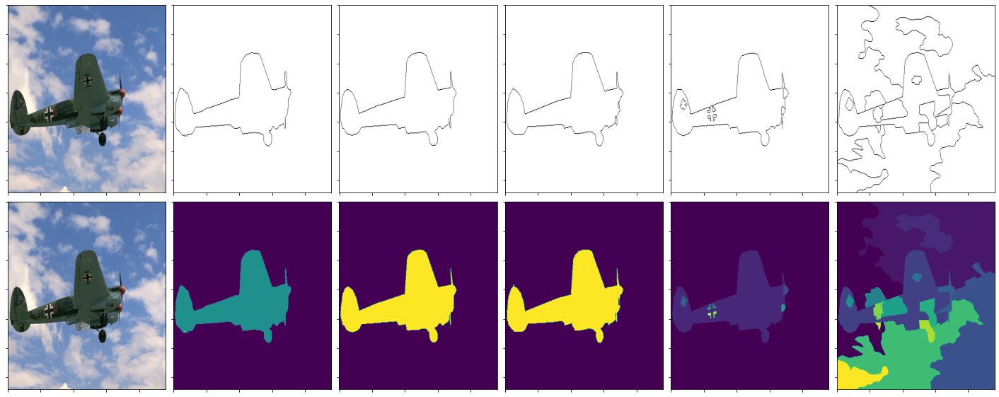

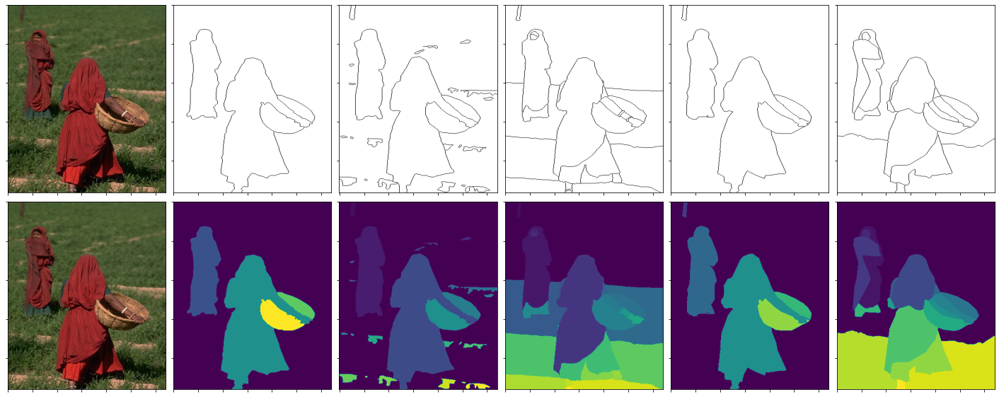

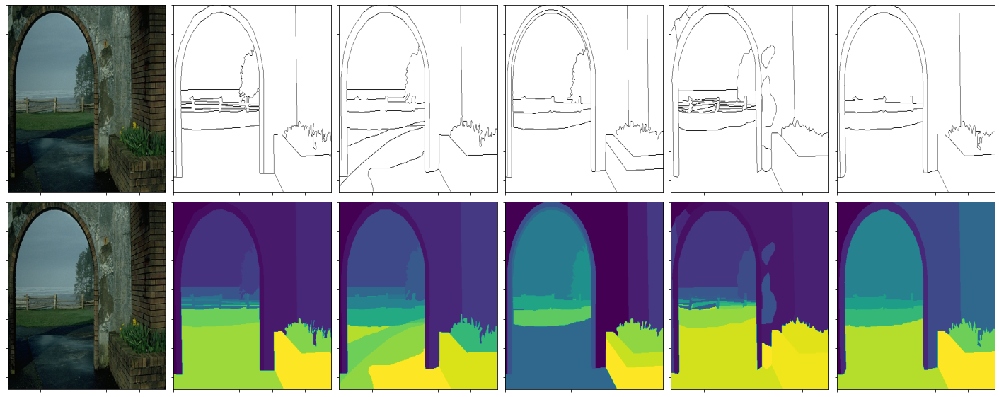

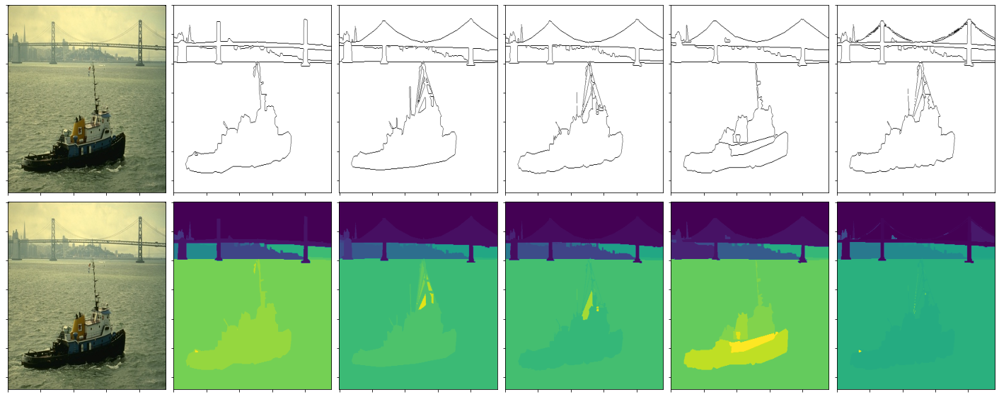

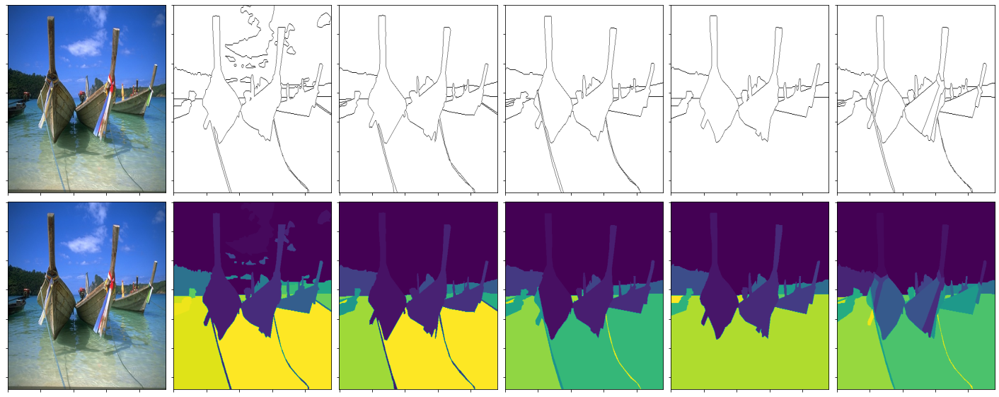

...

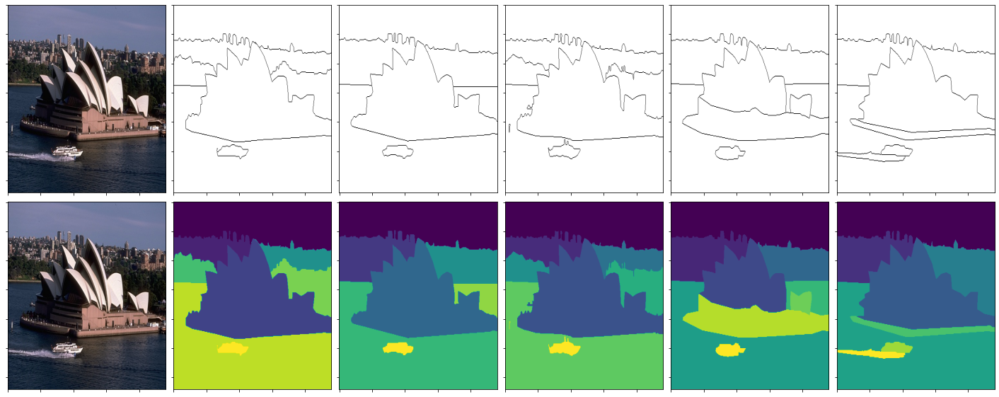

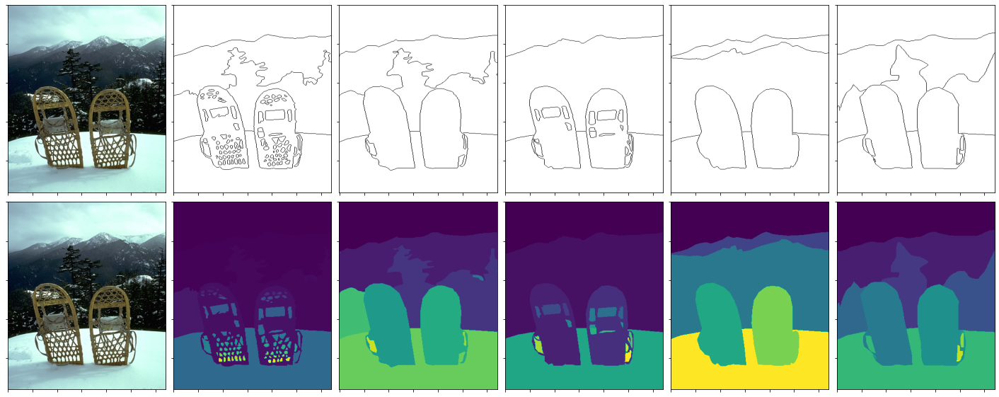

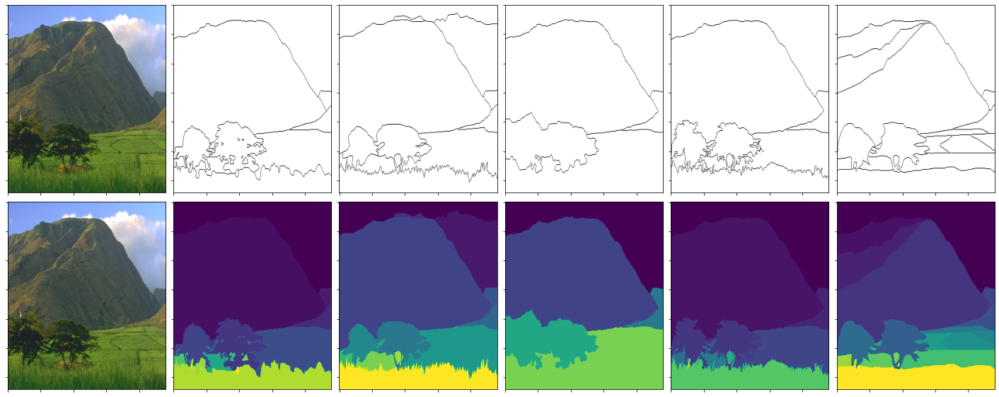

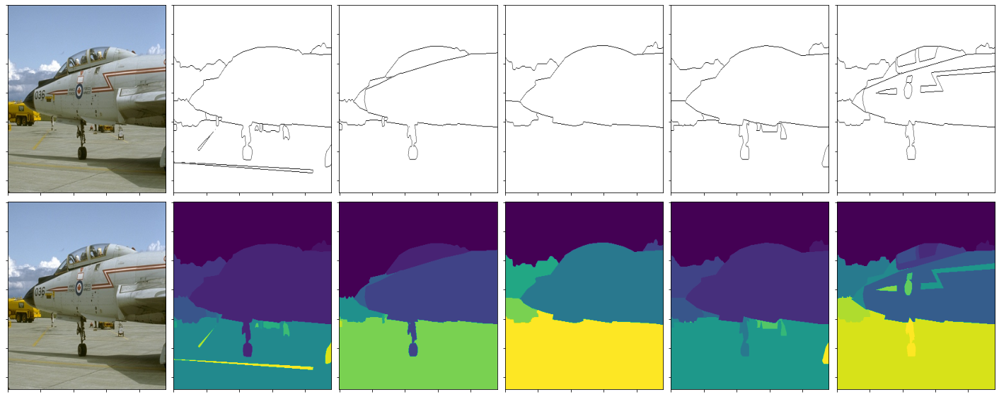

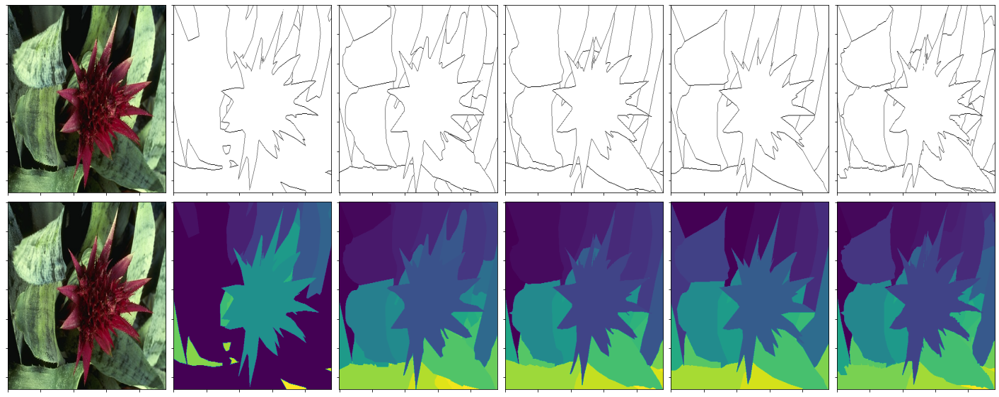

In [ ]:
display_image_and_ground_truth(0)
display_image_and_ground_truth(49)
display_image_and_ground_truth(10)

#Segmentation using K-means

In [ ]:
def kmean(D, k, e):
  firstTime = True
  error = 1000000
  m = [0 for i in range(k)]
  mnew = [0 for i in range(k)]
  clusters = [0 for i in range(len(D))]
  
  for i in range(k):
    unique = False
    m[i] = np.array(D[random.randint(0, len(D)-1)])
    while(not unique):
      for j in range(i):
        if(isIdentical(m[i], m[j])):
          m[i] = np.array(D[random.randint(0, len(D)-1)])
          break
      unique = True


  while(error > e or firstTime):
    firstTime = False
    C = [[] for i in range(k)]
    for i in range(len(D)):
      min = k-1
      for j in range(k-1):
        min = j if(np.linalg.norm(D[i]-m[j]) <= np.linalg.norm(D[i]-m[min])) else min
      C[min].append(D[i])
      clusters[i] = min
    C = np.array(C, dtype=object)
    for i in range(k):
      C[i] = np.array(C[i], dtype=object)
    for i in range(k):
      ones = np.array([[1] for i in range(len(C[i]))])

      mnew[i] = np.matmul(C[i].T, ones)
      mnew[i] = ((mnew[i].T)/len(C[i])).ravel()

    scc = np.subtract(mnew, m)

    error = 0
    for i in range(len(scc)):
      error = error + np.matmul(scc[i], scc[i].T)
    m = mnew
  C = [[] for i in range(k)]
  for i in range(len(D)):
    min = k-1
    for j in range(k-1):
      min = j if(np.linalg.norm(D[i]-m[j]) < np.linalg.norm(D[i]-m[min])) else min
    C[min].append(D[i])
    clusters[i] = min
  C = np.array(C)

  for i in range(k):
    C[i] = np.array(C[i])
  return clusters,m

def isIdentical(x, y):
  return True if(np.linalg.norm(x-y) == 0) else False

In [ ]:
# Evaluate the result segmentation using F-measure.
def F_measure(y_true, y_pred, k):
  print(y_true.shape)
  print(y_true)
  print(y_pred.shape)
  print(y_pred)
  contingencyMatrix = metrics.cluster.contingency_matrix(y_true, y_pred).T
  perc = []
  recall = []
  fmeasure = 0

  for i in range(contingencyMatrix.shape[0]):
    perc.append(max(contingencyMatrix[i]) / np.sum(contingencyMatrix[i]))
    maxindex = np.argmax(contingencyMatrix[i])
    recall.append(max(contingencyMatrix[i]) / np.sum(contingencyMatrix[:,maxindex]))
    fmeasure = fmeasure + (2*perc[i]*recall[i])/(perc[i]+recall[i])

  return fmeasure / k

In [ ]:
# Evaluate the result segmentation using Conditional Entropy.
def Entropy(y_true, y_pred, k):

  contingencyMatrix = metrics.cluster.contingency_matrix(y_true, y_pred).T
  temp = 0
  HSC = []
  
  for i in range(contingencyMatrix.shape[0]):
      for j in range(contingencyMatrix.shape[1]):
        denim = 0
        
        if contingencyMatrix[i][j] / np.sum(contingencyMatrix[i]) != 0:
          denim = np.log10(contingencyMatrix[i][j] / np.sum(contingencyMatrix[i]))
        
        temp += (-contingencyMatrix[i][j] / np.sum(contingencyMatrix[i])) * denim

      HSC.append(temp)
      temp = 0

  HSC = np.array(HSC)
  HSCResult = 0
  
  for i in range(contingencyMatrix.shape[0]):
    temp = np.sum(contingencyMatrix[i])/ np.sum(contingencyMatrix)
    HSCResult += temp * HSC[i]

  return HSCResult

In [ ]:
# Segmentation using K-means
def Segmentation(index):
  testImg = orginal_images[index]
  Img=testImg.reshape((-1,3))
  width = testImg.shape[0]
  height = testImg.shape[1]

  f, axes = plt.subplots(1, 6, figsize=(20,5))
  # change the K of the K-means algorithm between {3,5,7,9,11} clusters.
  k = [3,5,7,9,11]
  
  seg = []
  fmeasure = np.zeros((5,5))
  entropy = np.zeros((5,5))

  # loop for the 5 values.
  for idx in range(5):
    labels,centers=kmean(Img, k[idx], 0.2)
   
  
     # Evaluate the result segmentation using F-measure, Conditional Entropy
    for h in range(5):
      # Two helper fncs
      fmeasure[idx][h] = F_measure(ground_truth_segmentation[index * 5 + h], labels, k[idx])
      entropy[idx][h] = Entropy(ground_truth_segmentation[index * 5 + h], labels, k[idx])
    
    centers = np.uint8(centers)
    labels=np.array(labels)
    segmentedData = centers[labels.flatten()]
    segmentedImg = segmentedData.reshape((testImg.shape))
    segmentedImg = np.array([j for j in labels]).reshape(width, height) 
    seg.append(segmentedImg)
  
  axes[0].imshow(testImg, aspect='auto')
  axes[0].axis('off')

  for idx in range(1,6):
    axes[idx].imshow(seg[idx - 1] , aspect='auto')
    axes[idx].axis('off')

  print('\n ** Average fmeasure for each K **')
  print(np.mean(fmeasure, axis=1))
  print(' ** Average entropy for each K **')
  print(np.mean(entropy, axis=1))
  plt.subplots_adjust(wspace=0.02,hspace=0.02)
  plt.show()

In [ ]:
Segmentation(10)

#Big Picture 

##a)

In [ ]:
def segmentation_kmeans (index , k=5) :
  testImg = orginal_images[index]
  Img=testImg.reshape((-1,3))
  width = testImg.shape[0]
  height = testImg.shape[1]
  labels,centers=kmean(Img, k, 0.2)
  centers = np.uint8(centers)
  labels=np.array(labels)
  segmentedData = centers[labels.flatten()]
  segmentedImg = segmentedData.reshape((testImg.shape))
  segmentedImg = np.array([j for j in labels]).reshape(width, height) 
  plt.title('K-means output')
  plt.imshow(segmentedImg)
  plt.show()
  


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


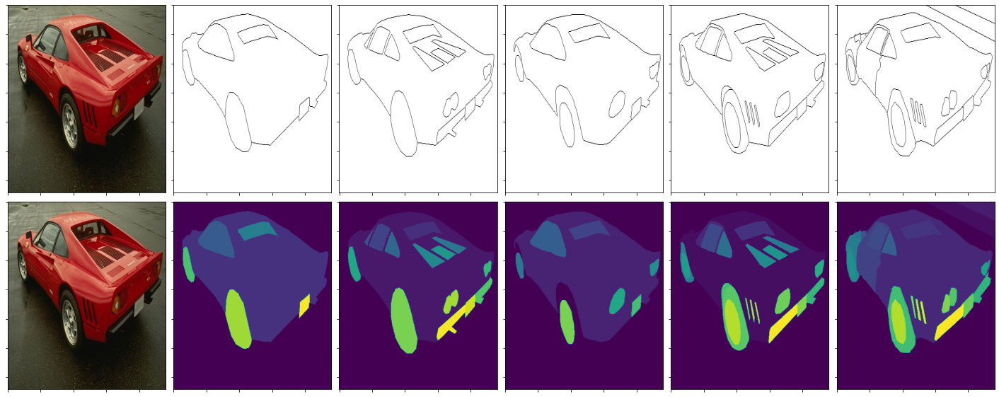

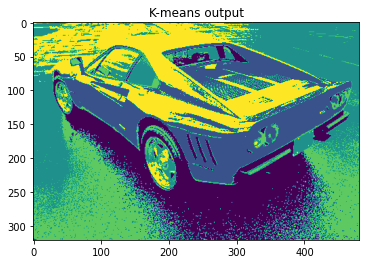

In [ ]:
segmentation_kmeans(1)
display_image_and_ground_truth(1)



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


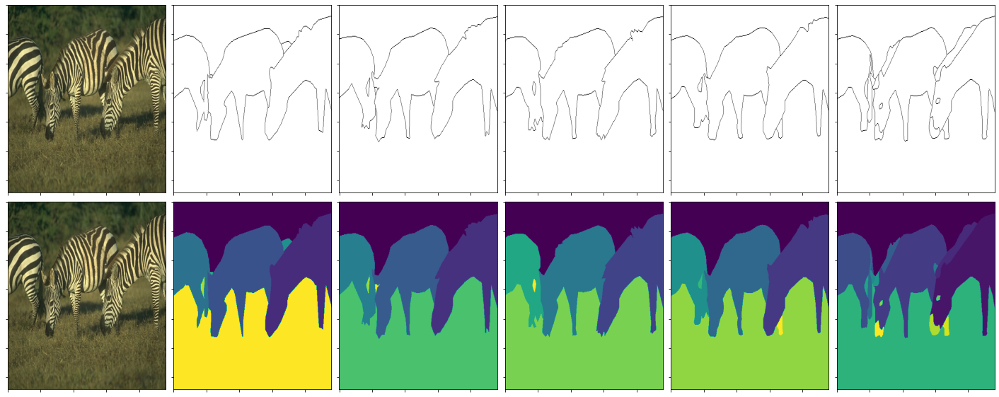

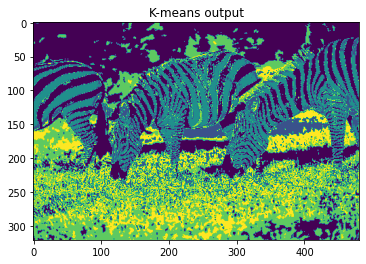

In [ ]:
segmentation_kmeans(5)
display_image_and_ground_truth(5)



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


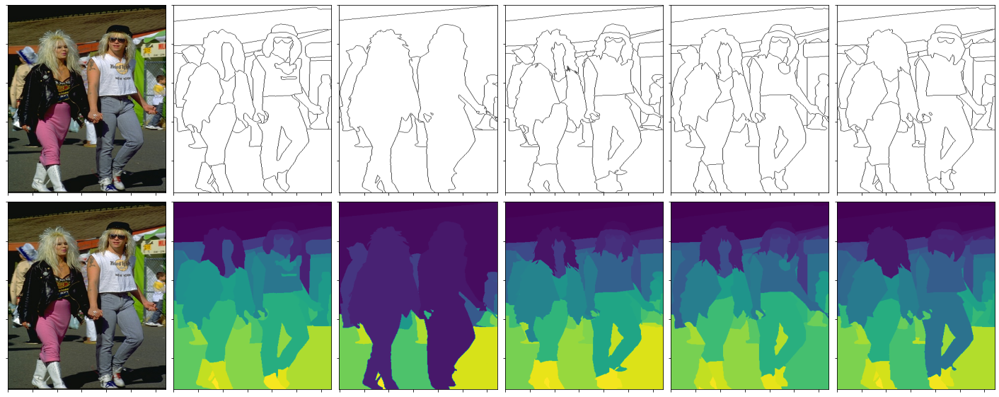

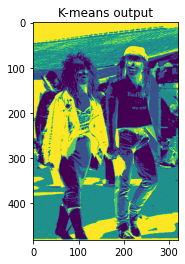

In [ ]:
segmentation_kmeans(10)
display_image_and_ground_truth(10)


In [ ]:
segmentation_kmeans(20)
display_image_and_ground_truth(20)



In [ ]:
segmentation_kmeans(15)
display_image_and_ground_truth(15)



#b) & c)

In [ ]:
import math
from sklearn.metrics.pairwise import rbf_kernel

def NN_CUT (points ,k , gamma = 0.06): 
  print("Enter")

  A = rbf_kernel(points, gamma = gamma)
  
  # def genSim (data):
  #     ans =[]
  #     for p1 in points :
  #       temp = []
  #       for p2 in points :
  #         #temp.append( np.linalg.norm( np.subtract (np.asarray(p1) , np.asarray(p2)  ) )   )
  #         temp.append( math.exp ( - gamma * np.linalg.norm( np.subtract (np.asarray(p1) , np.asarray(p2) ) ) ) ) # RBF
  #       ans.append(temp)
  #     return ans
  # A = genSim(points)
  print("A  computed")
 
  A = np.asarray(A)
  D = np.diag(np.sum(np.array(A), axis=1))
  print("A , D computed")


  L = D - A

  degS = D ** (-1/2)
  
  print("degS computed")

  degS[degS == np.inf ] =0

  Ls =  degS  @ L @ degS  

  print("Ls computed")

  eigenValues, eigenVectors = np.linalg.eig(Ls)

  idx = eigenValues.argsort()   
  eigenValues = eigenValues[idx]
  eigenVectors = eigenVectors[:,idx]

  Y =  eigenVectors[:,0:k]
  Y =np.real(Y)

  print("Y computed")


  for (i , row) in  enumerate (Y) :
    # sum = np.sum(row)
    # sum = 0.0001 if sum ==0 else sum  
    Y[i]= np.divide(row ,np.linalg.norm( row  ) )

  labels,centers=kmean(Y, k, 0.2)
  return labels,centers

In [ ]:
# testImg = orginal_images[0]
# Img=testImg.reshape((-1,3))
# NN_CUT(Img , 5)

In [ ]:
from PIL import Image

def segmentation_NCUT (index ,k=5):
  testImg = orginal_images[index]
  width = testImg.shape[0]
  height = testImg.shape[1]

  image = Image.fromarray(testImg.astype(np.uint8))
  newsize = (int(height/4), int(width/4))

  image = image.resize(newsize)
  plt.imshow(image)
  plt.title("Original image ")
  plt.show()
  image2 = np.asarray(image)
  
  Img=image2.reshape((-1,3))

  print("img",Img.shape)


  gs = [0.001]           ##  testing diffrent gammas

    
  # setting values to rows and column variables
  rows = 1
  columns = len(gs)


  #print(Img.shape)

  

  for (i,g) in enumerate(gs):
    labels,centers=NN_CUT(Img, k, g)

    centers = np.uint8(centers)
    labels=np.array(labels)
    segmentedData = centers[labels.flatten()]
    segmentedImg = np.array([j for j in labels]).reshape( int(width/4)  , (int(height/4))) 

    #fig.add_subplot(rows, columns, i+1)
    plt.imshow(segmentedImg)
    plt.title("N_CUT , gamma = "+str(g))
    plt.show()
    #segmentedImg = segmentedData.reshape((image.shape))
    
    #print("labels",labels.shape)

  
  
  # print("segmentedImg",segmentedImg.shape , newsize)

  # plt.imshow(segmentedImg)
  # plt.title("N_Cut segmented image ")
  # plt.show()





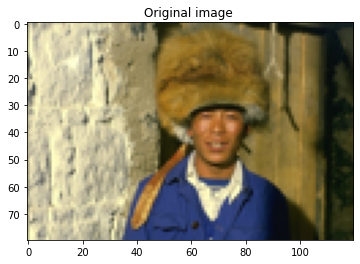

img (9600, 3)
Enter
A  computed
A , D computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:28: RuntimeWarning: divide by zero encountered in power


degS computed
Ls computed
Y computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


Enter
A  computed
A , D computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:28: RuntimeWarning: divide by zero encountered in power


degS computed
Ls computed
Y computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


Enter
A  computed
A , D computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:28: RuntimeWarning: divide by zero encountered in power


degS computed
Ls computed
Y computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


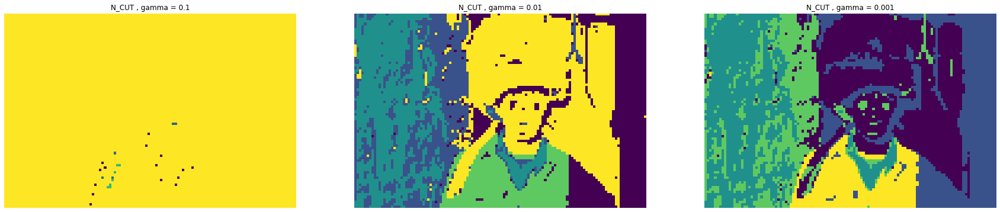

In [ ]:
segmentation_NCUT( 5)




In [ ]:
def segement_kmeans_small(index,k=5):
  testImg = orginal_images[index]
  width = testImg.shape[0]
  height = testImg.shape[1]

  image = Image.fromarray(testImg.astype(np.uint8))
  newsize = (int(height/4), int(width/4))

  image = image.resize(newsize)

  image2 = np.asarray(image)

  Img=image2.reshape((-1,3))

  labels,centers=kmean(Img, k,0.2)

  centers = np.uint8(centers)
  labels=np.array(labels)
  segmentedData = centers[labels.flatten()]
  segmentedImg = np.array([j for j in labels]).reshape( int(width/4)  , (int(height/4))) 
  plt.title('K-means output')
  plt.imshow(segmentedImg)
  plt.show()
  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


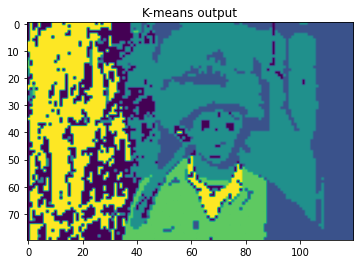

In [ ]:
segement_kmeans_small(5)

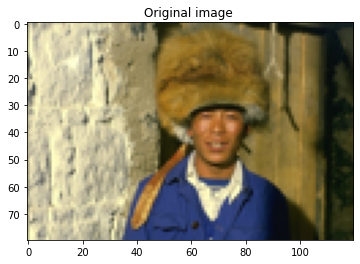

img (9600, 3)
Enter
A  computed
A , D computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:28: RuntimeWarning: divide by zero encountered in power


degS computed
Ls computed
Y computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


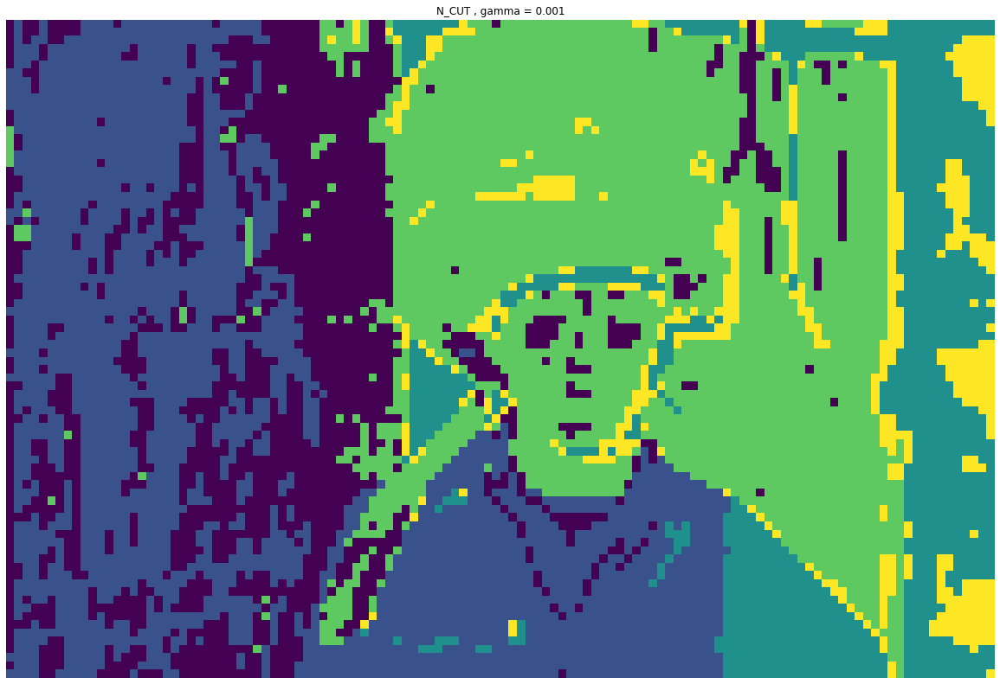

In [ ]:
segmentation_NCUT( 5)


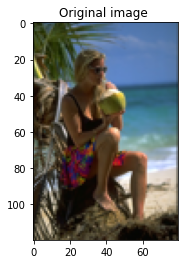

img (9600, 3)
Enter
A  computed
A , D computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:28: RuntimeWarning: divide by zero encountered in power


degS computed
Ls computed
Y computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


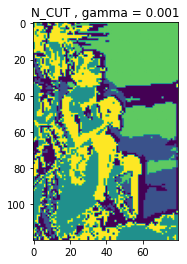

In [ ]:
segmentation_NCUT(10)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


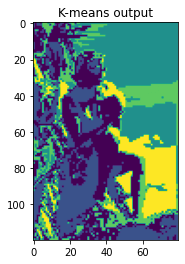

In [ ]:
segement_kmeans_small(10)

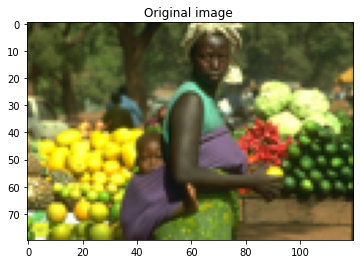

img (9600, 3)
Enter
A  computed
A , D computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:28: RuntimeWarning: divide by zero encountered in power


degS computed
Ls computed
Y computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


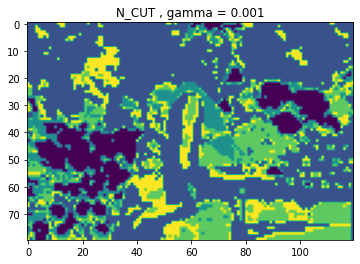

In [ ]:
segmentation_NCUT(16)


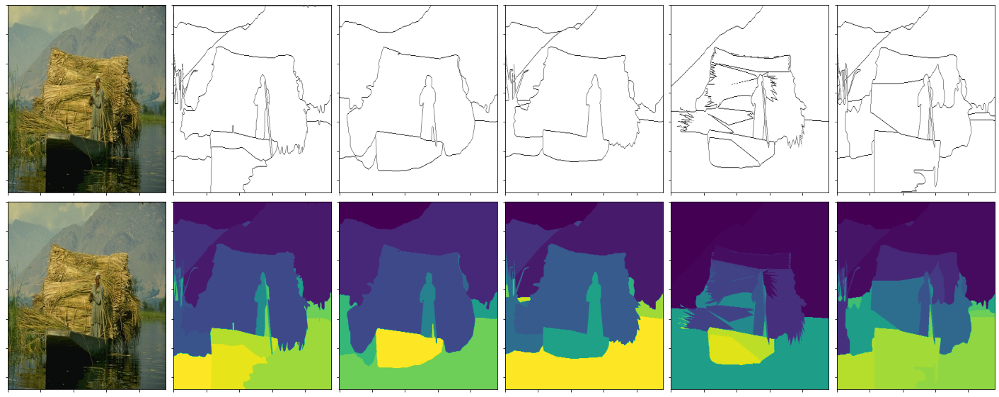

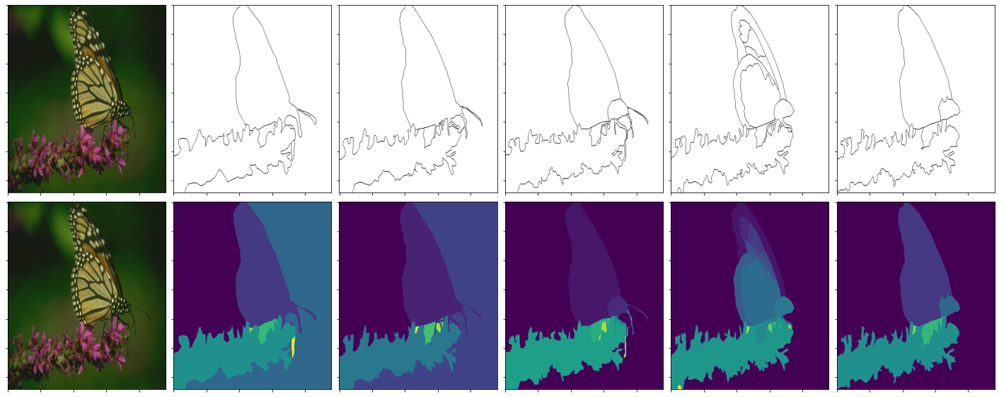

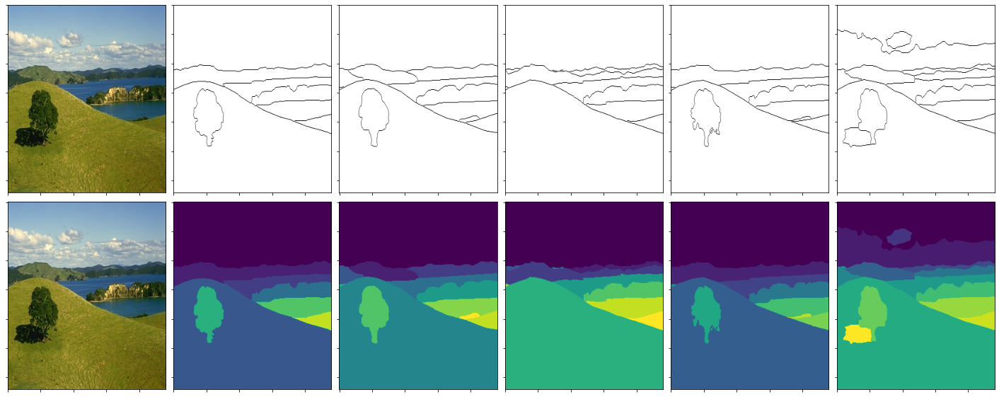

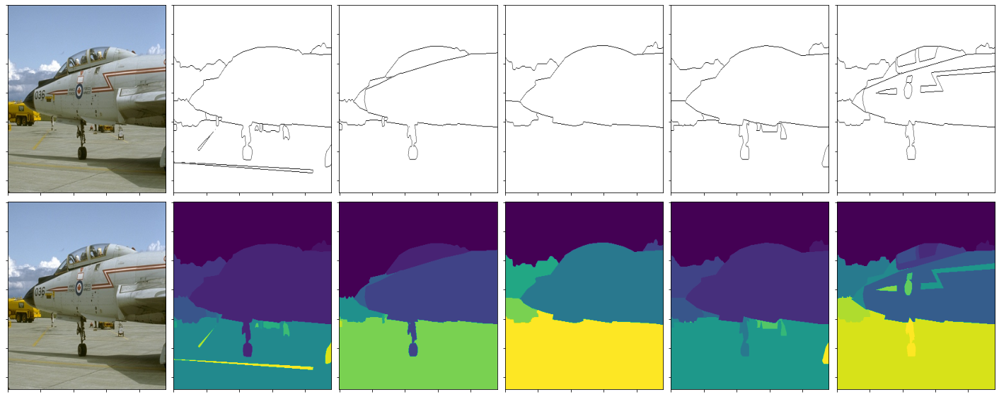

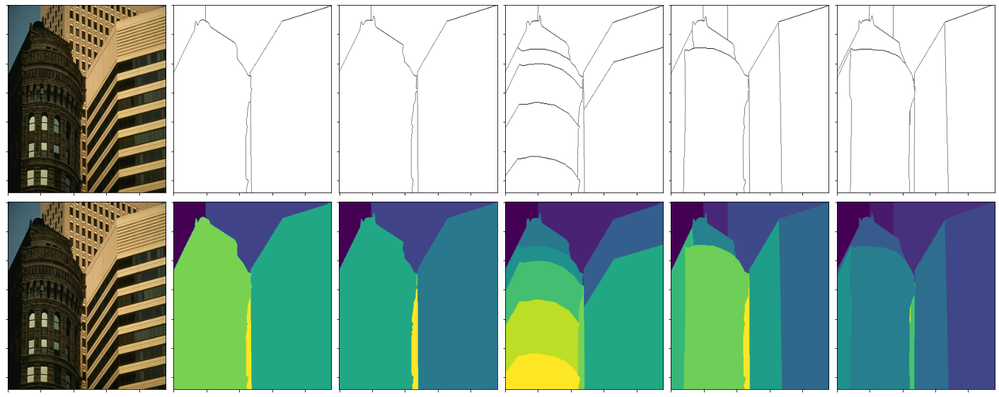

...

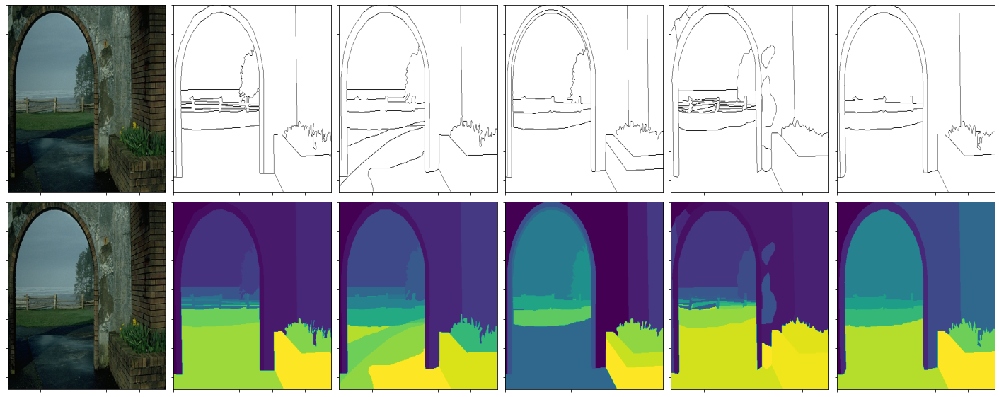

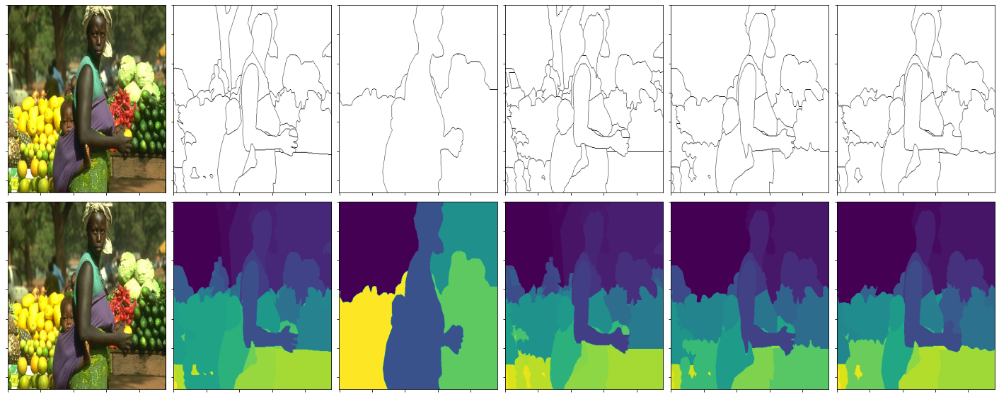

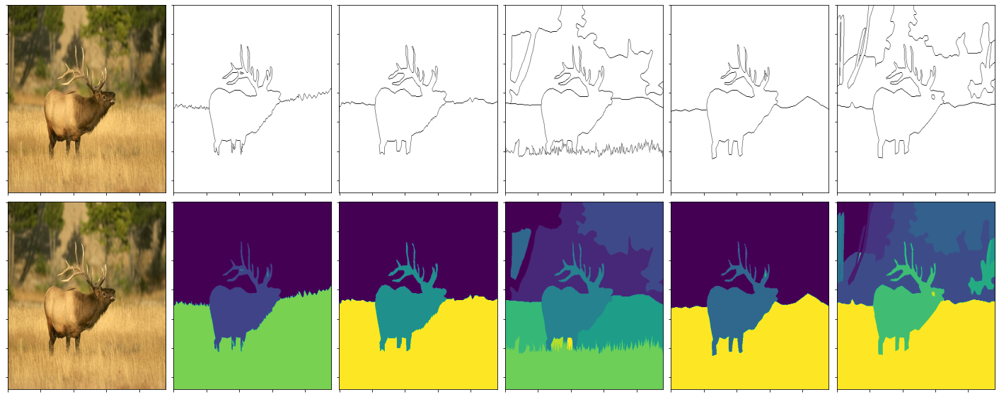

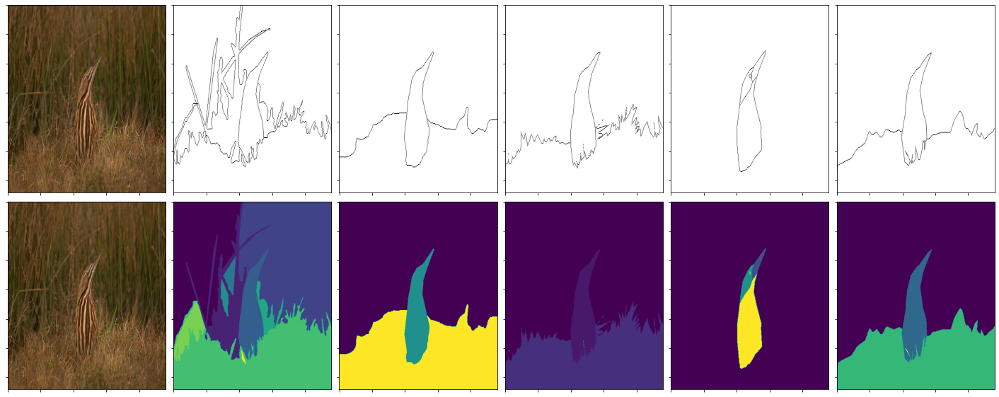

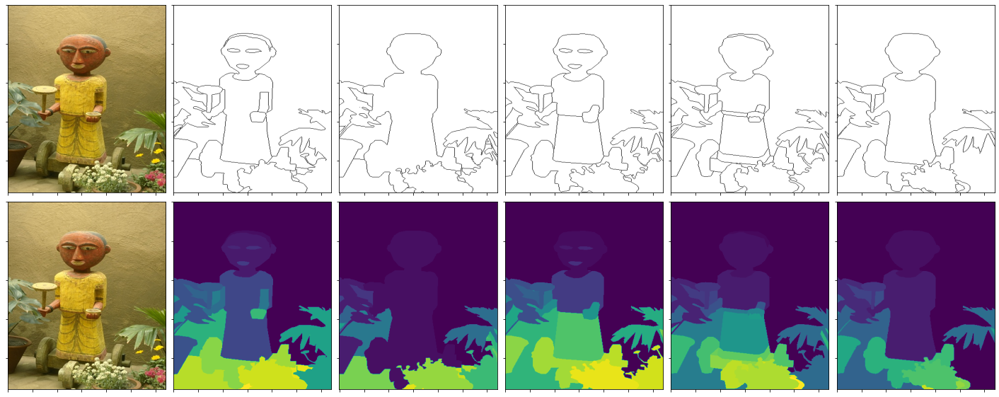

In [ ]:
#segmentation_NCUT(12)
for  i in range (20):
  display_image_and_ground_truth(i)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


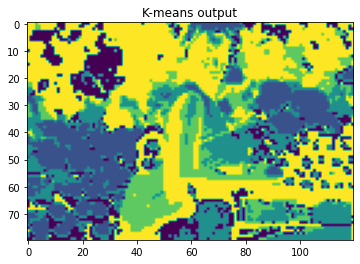

In [ ]:
segement_kmeans_small(16)

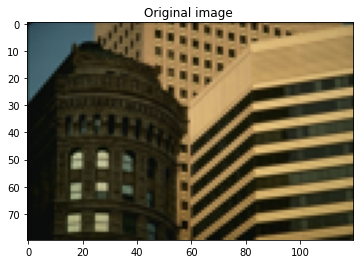

img (9600, 3)
Enter
A  computed
A , D computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:28: RuntimeWarning: divide by zero encountered in power


degS computed
Ls computed
Y computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


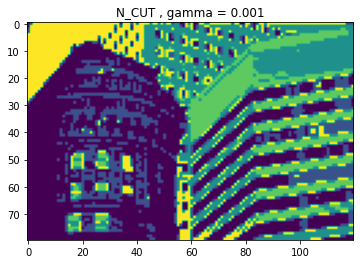

In [ ]:
segmentation_NCUT(4)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


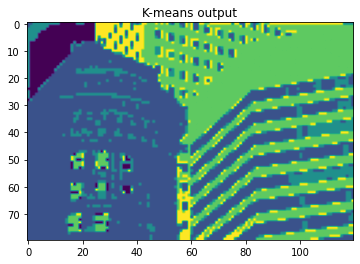

In [ ]:
segement_kmeans_small(4)

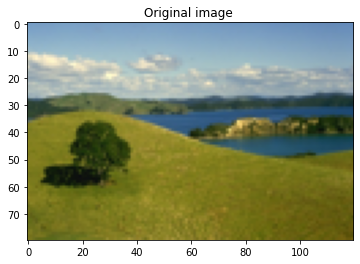

img (9600, 3)
Enter
A  computed
A , D computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:28: RuntimeWarning: divide by zero encountered in power


degS computed
Ls computed
Y computed


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


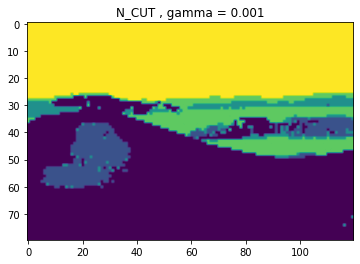

In [ ]:
segmentation_NCUT(2)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


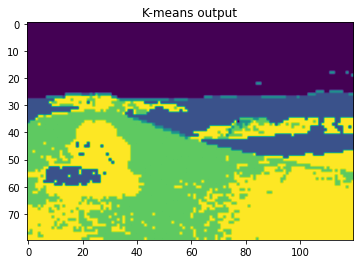

In [ ]:
segement_kmeans_small(2)

In [ ]:
from sklearn.cluster import spectral_clustering
testImg = orginal_images[10]
width = testImg.shape[0]
height = testImg.shape[1]

image = Image.fromarray(testImg.astype(np.uint8))
newsize = (int(height/6), int(width/6))

image = image.resize(newsize)
display(image)
image2 = np.asarray(image)

Img=image2.reshape((-1,3))

print("img",Img.shape)


#print(Img.shape)
A = rbf_kernel(Img, gamma = 0.1)
labels= spectral_clustering(A ,n_clusters=5)

#centers = np.uint8(centers)
labels=np.array(labels)
#segmentedData = centers[labels.flatten()]
#segmentedImg = segmentedData.reshape((image.shape))

print("labels",labels.shape)

segmentedImg = np.array([j for j in labels]).reshape((80,53)) 
print("segmentedImg",segmentedImg.shape , newsize)

plt.imshow(segmentedImg)
plt.show()
plt.imshow(testImg)
plt.show()



In [ ]:
# #  A = np.asarray([[0,1,0,1,0,1,0], [1,0,1,1,0,0,0],[0,1,0,1,0,0,1],[1,1,1,0,1,0,0],
#                   [0,0,0,1,0,1,1],[1,0,0,0,1,0,1],[0,0,1,0,1,1,0]])
#   D =np.asarray([[3, 0 ,0 ,0 ,0 ,0, 0] ,[0 ,3 ,0 ,0 ,0 ,0 ,0] ,[0 ,0 ,3 ,0 ,0 ,0 ,0] ,[0 ,0 ,0 ,4 ,0 ,0 ,0]
#                 ,[0 ,0 ,0 ,0 ,3 ,0 ,0], [0 ,0 ,0 ,0 ,0 ,3 ,0],[0 ,0 ,0 ,0 ,0 ,0 ,3]]) 


In [ ]:
from sklearn.metrics import pairwise_distances

A = np.array(
[[0, 1, 0, 0, 1],
[0, 0, 1, 1, 1],
[1, 1, 0, 1, 0]])

dist_out = 1-pairwise_distances(A, metric="euclidean")
dist_out

array([[ 1.        , -0.73205081, -0.73205081],
       [-0.73205081,  1.        , -1.        ],
       [-0.73205081, -1.        ,  1.        ]])

In [ ]:
# import numpy as np
# from sklearn.metrics.pairwise import rbf_kernel
# A = np.array(
# [[0, 1, 0, 0, 1],
# [0, 0, 1, 1, 1],
# [1, 1, 0, 1, 0]])

# rbf_kernel(A, gamma = 0.1)

array([[1.        , 0.74081822, 0.74081822],
       [0.74081822, 1.        , 0.67032005],
       [0.74081822, 0.67032005, 1.        ]])

#5. Extra

In [ ]:
def addSpatialAttributes (D , width , height):

  D = D / 255
  D = D.tolist()
 
  sp =[]

  for i in range(width):
    for j in range(height):
      D[i][j].append(i /width)
      D[i][j].append(j /height)

    sp.append(D[i])
  sp = np.asarray(sp)
  sp=sp.reshape((-1,5))
  return sp 



  


In [ ]:
def segmentation_kmeans_with_spatial (index , k=5) :
  testImg = orginal_images[index]
  print()
  width = testImg.shape[0]
  height = testImg.shape[1]
  D = addSpatialAttributes(testImg , width ,height)


  print(D)

  labels,centers=kmean(D, k, 0.2)
  centers = np.uint8(centers)
  labels=np.array(labels)
  segmentedData = centers[labels.flatten()]
  print(segmentedData.shape)
  #segmentedImg = segmentedData.reshape((testImg.shape))
  segmentedImg = np.array([j for j in labels]).reshape(width, height) 
  plt.title('K-means with spatial output')
  plt.imshow(segmentedImg)
  plt.show()



[[0.20784314 0.24313725 0.12156863 0.         0.        ]
 [0.23921569 0.2745098  0.15294118 0.         0.002079  ]
 [0.25882353 0.30196078 0.16862745 0.         0.004158  ]
 ...
 [0.2        0.20784314 0.12156863 0.99688474 0.99376299]
 [0.10196078 0.12156863 0.04313725 0.99688474 0.995842  ]
 [0.02352941 0.06666667 0.00392157 0.99688474 0.997921  ]]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


(154401, 5)


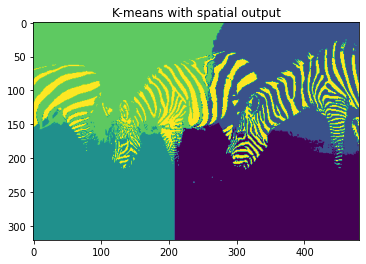

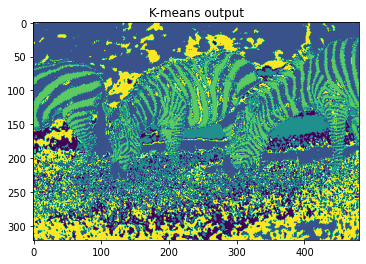

In [ ]:
#display_image_and_ground_truth(5)
segmentation_kmeans_with_spatial(5)
segmentation_kmeans(5)

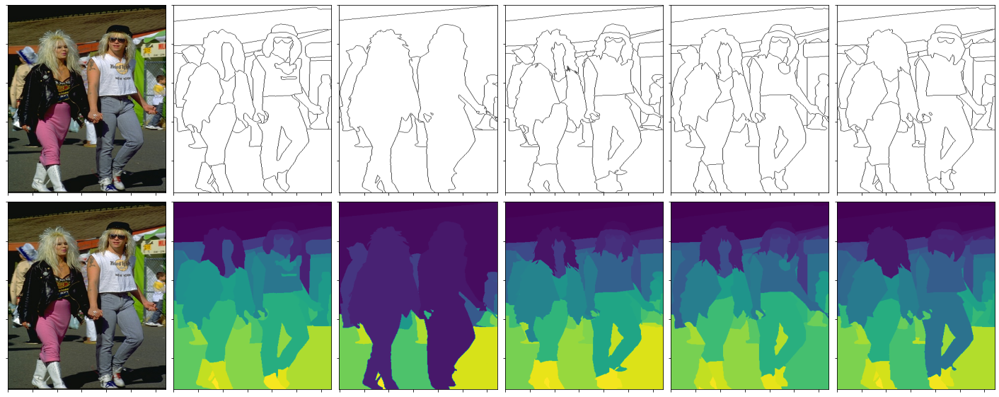


[[0.04705882 0.05490196 0.04313725 0.         0.        ]
 [0.05098039 0.05882353 0.04705882 0.         0.00311526]
 [0.05098039 0.05882353 0.04705882 0.         0.00623053]
 ...
 [0.05490196 0.05490196 0.04705882 0.997921   0.99065421]
 [0.05098039 0.05882353 0.04705882 0.997921   0.99376947]
 [0.05098039 0.05882353 0.04705882 0.997921   0.99688474]]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


(154401, 5)


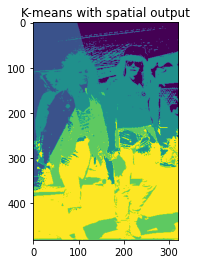

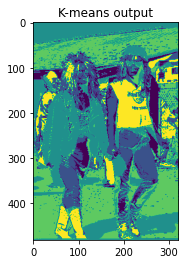

In [ ]:
display_image_and_ground_truth(10)
segmentation_kmeans_with_spatial(10)
segmentation_kmeans(10)

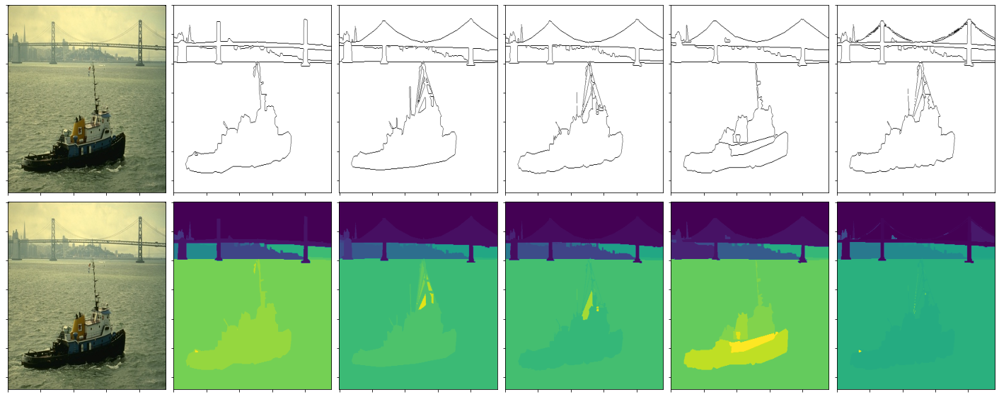


[[0.11372549 0.1372549  0.03529412 0.         0.        ]
 [0.16862745 0.19215686 0.09019608 0.         0.002079  ]
 [0.21568627 0.23137255 0.14117647 0.         0.004158  ]
 ...
 [0.33333333 0.38823529 0.29019608 0.99688474 0.99376299]
 [0.32156863 0.37647059 0.27843137 0.99688474 0.995842  ]
 [0.23137255 0.28627451 0.18823529 0.99688474 0.997921  ]]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


(154401, 5)


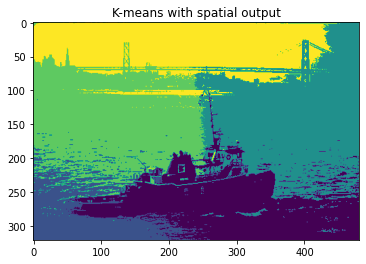

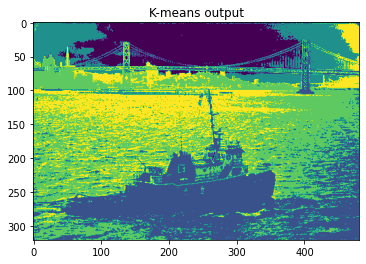

In [ ]:
display_image_and_ground_truth(12)
segmentation_kmeans_with_spatial(12)
segmentation_kmeans(12)

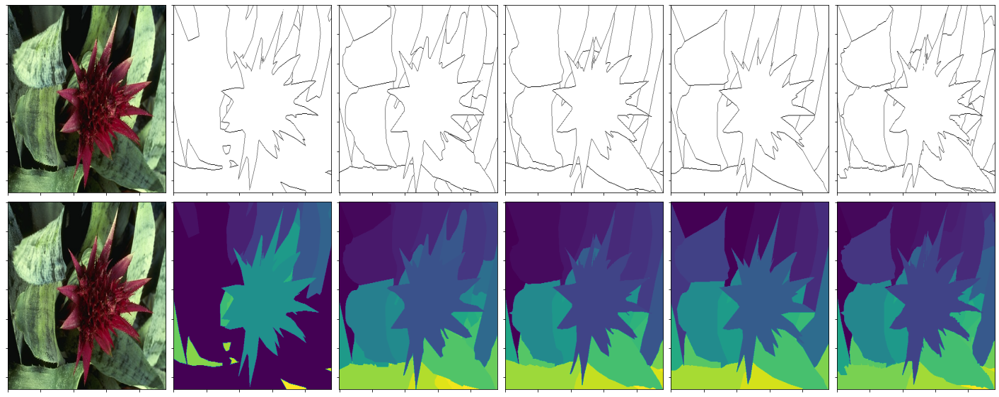


(154401, 5)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


(154401, 5)


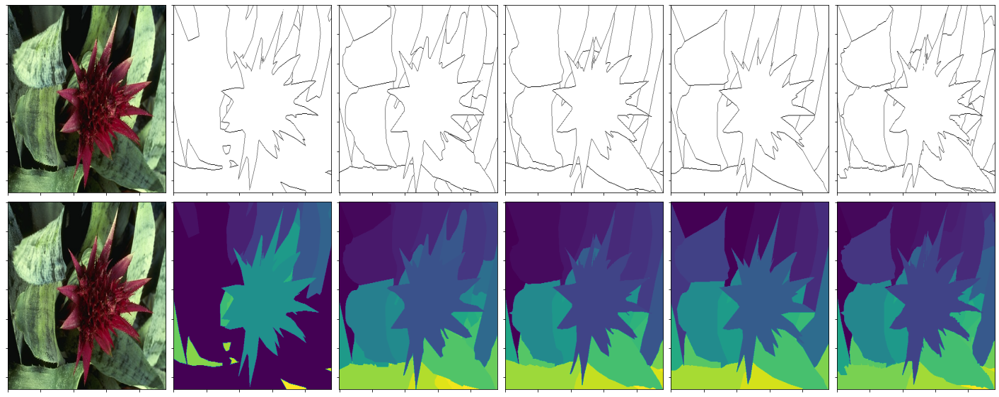

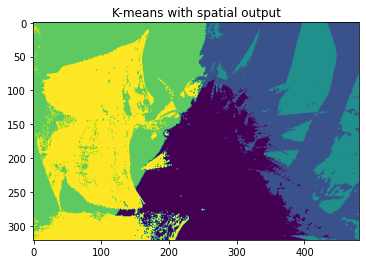

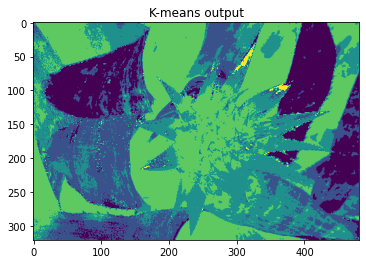

In [ ]:
display_image_and_ground_truth(4)
segmentation_kmeans_with_spatial(4)
segmentation_kmeans(4)

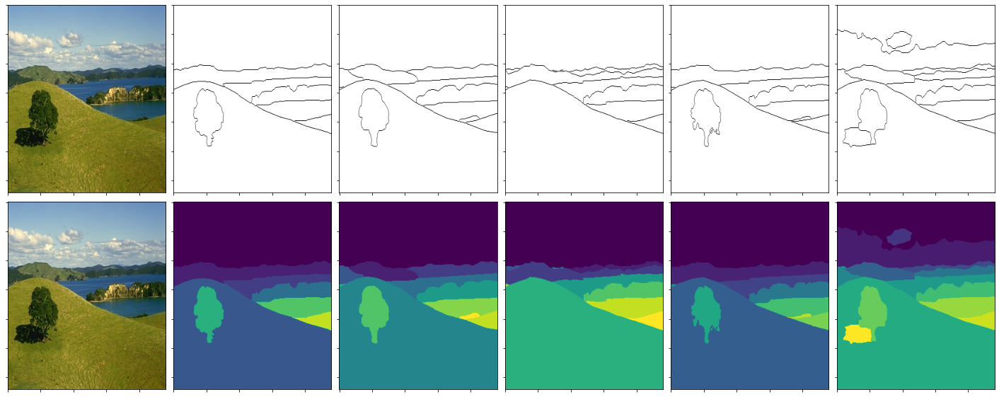


[[0.45490196 0.62352941 0.76078431 0.         0.        ]
 [0.45098039 0.61960784 0.75686275 0.         0.002079  ]
 [0.4627451  0.61568627 0.76862745 0.         0.004158  ]
 ...
 [0.40392157 0.3372549  0.03137255 0.99688474 0.99376299]
 [0.34509804 0.27843137 0.         0.99688474 0.995842  ]
 [0.36862745 0.30588235 0.         0.99688474 0.997921  ]]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


(154401, 5)


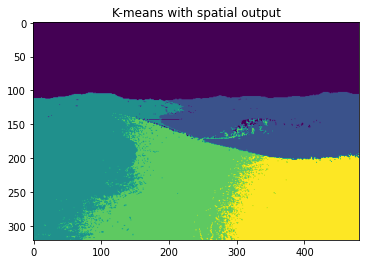

NameError: ignored

In [ ]:
display_image_and_ground_truth(2)
segmentation_kmeans_with_spatial(2)
segmentation_kmeans(2)